# Taller 4
### Andrés David Campos
### 201413737

In [42]:
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import numpy as np
import random as rd
from mpl_toolkits.mplot3d import Axes3D
import IPython.display as ipd
from scipy.signal import butter, lfilter
import sys
import librosa.display

Se importan las librerias que se usarán en este taller

# Basics of Fourier Series and the Fourier Transform¶

La transformada de Fourier es una herramienta que permite expresar una función en términos de series infinitas de senos y cosenos. Como se observa en la siguiente expresión: 

$f(x)=\frac{a_0}{2}+\sum_{n=1}^{\infty }(a_n\cos nx+b_n\sin nx)\; x\in (-\pi, \pi]$

Se encuentran los coeficientes de Fourier $a_n$ y $b_n$ por medio de las siguientes expresiones:

$a_n=\frac{1}{\pi}\int_{-\pi}^{\pi}f(x)\cos nx\: dx\; n\geq 0$

$b_n=\frac{1}{\pi}\int_{-\pi}^{\pi}f(x)\sin nx\: dx\; n> 0$

## The Fast Fourier Transform

La FFT (Transformada Rápida de Fourier) fue desarrollada con el fin de aplicar la transformada de Fourier de forma directa e inversa. Donde sus características son las siguientes:

* Bajo número de operaciones.
* Encuentra la transformada en el intervalo $x \in [-L, L]$.
* Disminuye el número de operacions por medio de la discretización del rango $x \in [-L, L]$ en $2^n$ puntos.
* Tiene muy buena exactitud en comparación con otros métodos de discretización.

## Fast Fourier Transform: FFT, IFFT, FFTSHIFT, IFFTSHIFT

A continuación se vera la aplicación práctica de la FFT utilizando la función Gaussiana:

$f(x)=\exp (\alpha x^2)\rightarrow \widehat{f}(k)=\frac{1}{\sqrt{2 \alpha}}\exp \left ( -\frac{k^2}{4 \alpha} \right )$

Donde $\alpha=1$:

/home/nbuser/anaconda3_501/lib/python3.6/site-packages/numpy/core/numeric.py:531: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


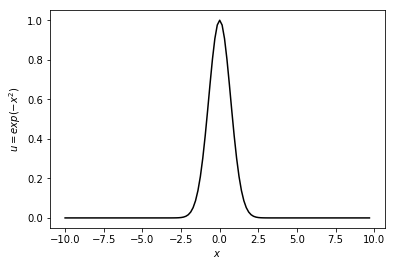

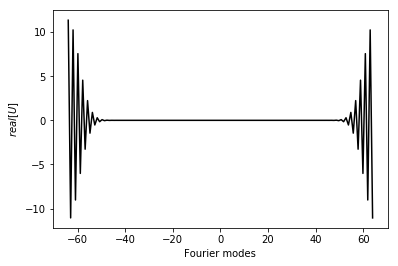

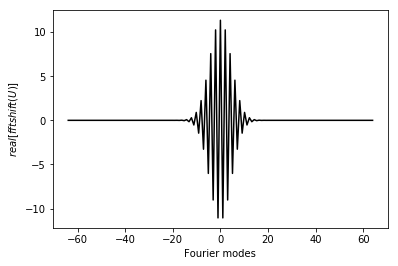

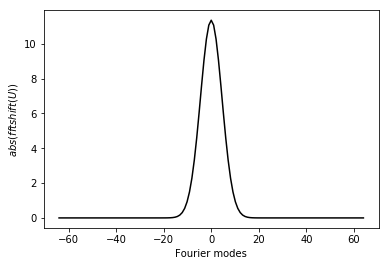

In [3]:
L = 20
n = 128
x2 = np.linspace(-L/2, L/2, n+1)
x = x2[0:n-1]
x3 = np.linspace(-n/2, n/2, n-1)

u = np.exp(-x**2)
ut = np.fft.fft(u)
utshift = np.fft.fftshift(ut)

#Función u
plt.figure() 
plt.plot(x, u, 'k')
plt.ylabel('$u=exp(-x^2)$')
plt.xlabel('$x$')

# Tranformada de Fourier de la función u
plt.figure() 
plt.ylabel('$real[U]$')
plt.xlabel('Fourier modes')
plt.plot(x3, ut, 'k')

# Transformada de Fourier cambiada
plt.figure()
plt.ylabel('$real[fftshift(U)]$')
plt.xlabel('Fourier modes')
plt.plot(x3, utshift, 'k')

# Transformada de Fourier cambiada absoluta
plt.figure() 
plt.ylabel('$abs(fftshift(U))$')
plt.xlabel('Fourier modes')
plt.plot(x3, np.abs(utshift), 'k');

/home/nbuser/anaconda3_501/lib/python3.6/site-packages/ipykernel/__main__.py:7: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.
/home/nbuser/anaconda3_501/lib/python3.6/site-packages/ipykernel/__main__.py:8: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.


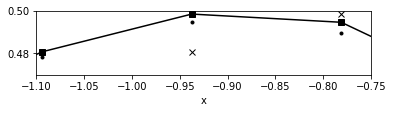

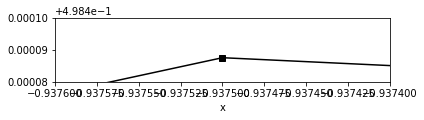

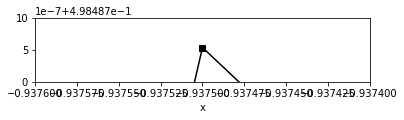

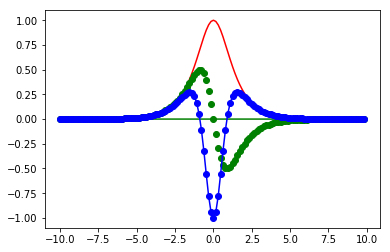

In [4]:
dx = x[2]-x[1]
x = x2[0:n]
u = 1/np.cosh(x)
du = -(1/np.cosh(x))*np.tanh(x)
d2u = (1/np.cosh(x))-2*(1/np.cosh(x))**3
ut = np.fft.fft(u)
k1 = np.array(np.linspace(0, n/2-1, n/2))
k2 = np.array(np.linspace(-n/2, -1, n/2))
kt = np.concatenate((k1, k2))
k = (2*np.pi/L)*kt

# FFT calculation of derivatives
ut1= k*ut
ut2 = -k*k*ut
u1 = np.fft.ifft(ut1).real
u2 = np.fft.ifft(ut2).real
u1exact = -(1/np.cosh(x))*np.tanh(x)
u2exact = (1/np.cosh(x))-2*(1/np.cosh(x))**3

# Finite difference calculation of first derivative
# 2nd-order accurate
ux=[]
ux.append((3*u[0]-4*u[1]+u[2])/(2*dx))
for i in range(1, n-1):
    uxi = (u[i+1]-u[i-1])/(2*dx)
    ux.append(uxi)
ux.append((3*u[n-1]-4*u[n-2]+u[n-3])/(2*dx))
# 4th-order accurate
ux2 = []
ux2.append((-3*u[0]+4*u[1]-u[2])/(2*dx))
ux2.append((-3*u[1]+4*u[2]-u[3])/(2*dx))
for i in range(1, n-2):
    uxi = (-u[i+2]+8*u[i+1]-8*u[i-1]+u[i-2])/(12*dx)
    ux2.append(uxi)
ux2.append((3*u[n-1]-4*u[n-2]+u[n-3])/(2*dx))
    
plt.figure()
plt.subplot(3,1,1)
plt.plot(x, u1exact, 'ks-')
plt.plot(x, u1, 'k')
plt.plot(x, ux, 'k.')
plt.plot(x, ux2, 'kx')
plt.ylim(0.47 ,0.5)
plt.xlim(-1.1, -0.75);
plt.xlabel('x')

plt.figure()
plt.subplot(3,1,1)
plt.plot(x, u1exact, 'ks-')
plt.plot(x, u1, 'kv')
plt.plot(x, ux, 'ko')
plt.plot(x, ux2, 'k*')
plt.ylim(0.49848 ,0.4985)
plt.xlim(-0.9376, -0.9374);
plt.xlabel('x')

plt.figure()
plt.subplot(3,1,1)
plt.plot(x, u1exact, 'ks-')
plt.plot(x, u1, 'k')
plt.plot(x, ux, 'k.')
plt.plot(x, ux2, 'kx')
plt.ylim(0.498487 ,0.498488)
plt.xlim(-0.9376, -0.9374)
plt.xlabel('x')

plt.figure()
plt.plot(x,u,'r',x,u1,'g',x,u1exact,'go',x,u2,'b',x,u2exact,'bo');

# FFT Application: Radar Detection and Filtering¶

Una de las aplicaciones de la FFT es el filtro de señales. Esto es especialmente importante en los radares, ya que un radar puede detectar ondas electromagneticas provenientes de muchas fuentes. Por lo que si se quiere detectar un cierto tipo de señal especifica, como la de un avión o un dron, se tienen que eliminar las otras señales de fondo.

Se empezará entonces generando una señal ideal:

/home/nbuser/anaconda3_501/lib/python3.6/site-packages/ipykernel/__main__.py:5: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.
/home/nbuser/anaconda3_501/lib/python3.6/site-packages/ipykernel/__main__.py:6: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.


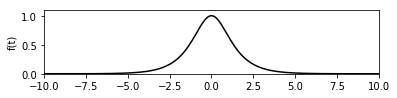

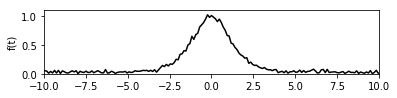

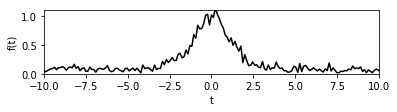

In [5]:
L = 30
n = 512
t2 = np.linspace(-L, L, n+1)
t = t2[0:n]
k1 = np.array(np.linspace(0, n/2-1, n/2))
k2 = np.array(np.linspace(-n/2, -1, n/2))
kt = np.concatenate((k1, k2))
k = (2*np.pi/(2*L))*kt

u = 1/np.cosh(t)
plt.figure()
plt.subplot(3,1,1)
plt.plot(t, u, 'k')
plt.ylabel('f(t)')
plt.xlim(-10, 10)
plt.ylim(0, 1.1)

noise = 2
rand1 = np.zeros(n)
rand2 = np.zeros(n)
ut = np.fft.fft(u)

for i in range(0, n):
    rand1[i]=rd.random()
    rand2[i]=rd.random()
utn = ut+noise*(rand1)+noise*(rand2)*1j
un = np.fft.ifft(utn)

plt.figure()
plt.subplot(3,1,2)
plt.plot(t, abs(un), 'k')
plt.ylabel('f(t)')
plt.xlim(-10, 10)
plt.ylim(0, 1.1)

noise2=5
rand3 = np.zeros(n)
rand4 = np.zeros(n)
for j in range(0, n):
    rand3[j]=rd.random()
    rand4[j]=rd.random()
unt = ut+noise2*rand3+noise2*rand4*1j
un2 = np.fft.ifft(unt)

plt.figure()
plt.subplot(3,1,3)
plt.plot(t, abs(un2), 'k')
plt.xlim(-10, 10)
plt.ylim(0, 1.1)
plt.ylabel('f(t)')
plt.xlabel('t');

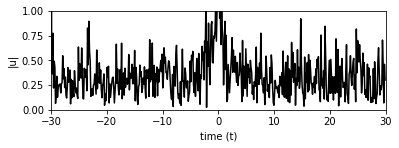

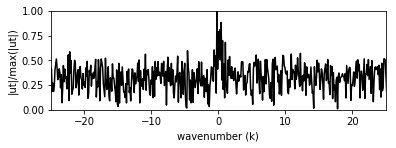

In [6]:
noise3 = 20
ut = np.fft.fft(u)
ra = np.zeros(n)
ra2 = np.zeros(n)
for i in range(0, n):
    ra[i]=rd.random()
    ra2[i]=rd.random()
unt = ut+noise3*(ra+ra2*1j)
un3 = np.fft.ifft(unt)

plt.figure()
plt.subplot(2,1,1) 
plt.plot(t,abs(un3),'k')
plt.xlim(-30, 30)
plt.ylim(0, 1)
plt.xlabel('time (t)')
plt.ylabel('|u|')

plt.figure()
plt.subplot(2,1,2)
plt.plot(np.fft.fftshift(k),np.abs(np.fft.fftshift(unt))/max(np.abs(np.fft.fftshift(unt))),'k')
plt.xlim(-25, 25)
plt.ylim(0, 1)
plt.xlabel('wavenumber (k)')
plt.ylabel('|ut|/max(|ut|)');

Existen una gran variedad de filtros utilizados para un radar. En este caso se utiliza el siguiente filtro:

$F(k)=\exp (-0.2k^2)$

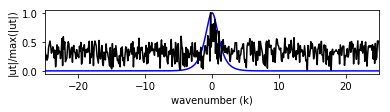

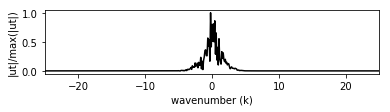

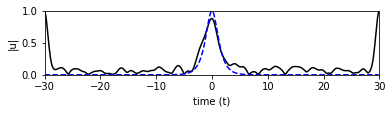

In [7]:
filtro=np.exp(-0.2*(k**2))
unft=filtro*unt
unf=np.fft.ifft(unft)

plt.figure()
plt.subplot(3,1,1)
plt.xlim(-25, 25)
plt.xlabel('wavenumber (k)')
plt.ylabel('|ut|/max(|ut|)')
plt.plot(np.fft.fftshift(k), u, 'b', np.fft.fftshift(k),np.abs(np.fft.fftshift(unt))/max(np.abs(np.fft.fftshift(unt))),'k')

plt.figure()
plt.subplot(3,1,2)
plt.plot(np.fft.fftshift(k),np.abs(np.fft.fftshift(unft))/max(np.abs(np.fft.fftshift(unft))), 'k')
plt.xlim(-25, 25)
plt.xlabel('wavenumber (k)')
plt.ylabel('|ut|/max(|ut|)')

plt.figure()
plt.subplot(3,1,3)
plt.plot(t,np.abs(unf),'k')
plt.plot(t,np.abs(u),'b--')
plt.xlabel('time (t)')
plt.ylabel('|u|')
plt.ylim(0, 1)
plt.xlim(-30, 30);

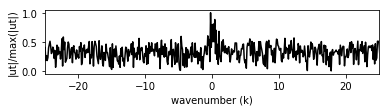

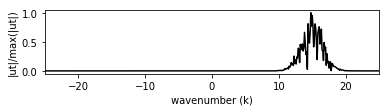

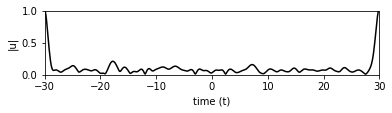

In [8]:
filtro=np.exp(-0.2*((k-15)**2))
unft=filtro*unt
unf=np.fft.ifft(unft)

plt.figure()
plt.subplot(3,1,1)
plt.xlim(-25, 25)
plt.xlabel('wavenumber (k)')
plt.ylabel('|ut|/max(|ut|)')
plt.plot(np.fft.fftshift(k),np.abs(np.fft.fftshift(unt))/max(np.abs(np.fft.fftshift(unt))),'k')

plt.figure()
plt.subplot(3,1,2)
plt.plot(np.fft.fftshift(k),np.abs(np.fft.fftshift(unft))/max(np.abs(np.fft.fftshift(unft))), 'k')
plt.xlim(-25, 25)
plt.xlabel('wavenumber (k)')
plt.ylabel('|ut|/max(|ut|)')

plt.figure()
plt.subplot(3,1,3)
plt.plot(t,np.abs(unf),'k')
plt.xlabel('time (t)')
plt.ylabel('|u|')
plt.ylim(0, 1)
plt.xlim(-30, 30);


# FFT Application: Radar Detection and Averaging¶¶

En esta sección se busca reducir el ruido del sistema por medio de un ponderado:

/home/nbuser/anaconda3_501/lib/python3.6/site-packages/ipykernel/__main__.py:5: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.
/home/nbuser/anaconda3_501/lib/python3.6/site-packages/ipykernel/__main__.py:6: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.
/home/nbuser/anaconda3_501/lib/python3.6/site-packages/ipykernel/__main__.py:26: ComplexWarning: Casting complex values to real discards the imaginary part
/home/nbuser/anaconda3_501/lib/python3.6/site-packages/ipykernel/__main__.py:29: ComplexWarning: Casting complex values to real discards the imaginary part


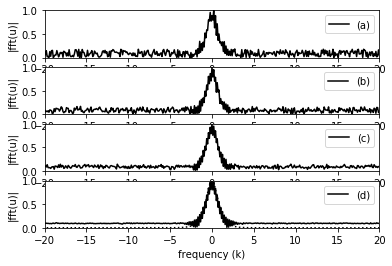

In [9]:
L = 30
n = 512
t2 = np.linspace(-L, L, n+1)
t = t2[0:n]
k1 = np.array(np.linspace(0, n/2-1, n/2))
k2 = np.array(np.linspace(-n/2, -1, n/2))
kt = np.concatenate((k1, k2))
k = (2*np.pi/(2*L))*kt
ks = np.fft.fftshift(k)
noise = 5.5
labels=np.array(['(a)','(b)','(c)','(d)'])
realize=np.array([1, 2, 5, 100])
for jj,i in enumerate(realize):
    utn=np.zeros((i,n))
    dat=np.zeros((i,n))
    un=np.zeros((i,n))
    u=1/np.cosh(t)
    ave=np.zeros((1,n))
    ut=np.fft.fft(u)
    for j in range(0, i):
        ra = np.zeros(n)
        ra2 = np.zeros(n)
        for z in range(0, n):
            ra[z]=rd.random()
            ra2[z]=rd.random()
        utn[j,:]=ut+noise*ra+noise*ra2*1j
        ave=ave+utn[j,:]
        dat[j,:]= abs(np.fft.fftshift(utn[j,:]))/(max(abs(utn[j,:])))     
        un[j,:]=np.fft.ifft(utn[j,:])
    ave=abs(np.fft.fftshift(ave))/i
    plt.subplot(4,1,jj+1)
    plt.plot(ks,ave[0,:]/max(ave[0,:]),'k',label=labels[jj])
    plt.xlim(-20, 20)
    plt.ylim(0, 1)
    plt.legend(loc='upper right')
    plt.ylabel('|fft(u)|')
plt.plot(ks,abs(np.fft.fftshift(ut))/max(abs(ut)),'k:')
plt.xlabel('frequency (k)');

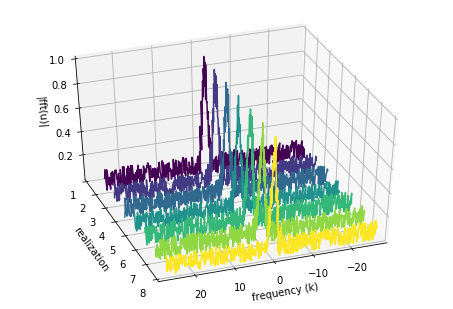

In [10]:
fig =plt.figure()
ax=Axes3D(fig)
y=np.array([1,2,3,4,5,6,7,8,9])
X,Y =np.meshgrid(ks,y)
p=ax.contour(X,Y, dat[0:9,:],zdir='y',extend3d=False)
plt.xlabel('frequency (k)')
plt.ylabel('realization')
plt.xlim(-28,28)
plt.ylim(1,8)
ax.set_zlabel('|fft(u)|')
ax.view_init(40,70)

/home/nbuser/anaconda3_501/lib/python3.6/site-packages/mpl_toolkits/mplot3d/axes3d.py:1714: ComplexWarning: Casting complex values to real discards the imaginary part
  v1[which_pt] = np.array(ps2[i1]) - np.array(ps2[i2])
/home/nbuser/anaconda3_501/lib/python3.6/site-packages/mpl_toolkits/mplot3d/axes3d.py:1715: ComplexWarning: Casting complex values to real discards the imaginary part
  v2[which_pt] = np.array(ps2[i2]) - np.array(ps2[i3])
/home/nbuser/anaconda3_501/lib/python3.6/site-packages/numpy/core/numeric.py:531: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/home/nbuser/anaconda3_501/lib/python3.6/site-packages/ipykernel/__main__.py:27: ComplexWarning: Casting complex values to real discards the imaginary part
/home/nbuser/anaconda3_501/lib/python3.6/site-packages/ipykernel/__main__.py:30: ComplexWarning: Casting complex values to real discards the imaginary part
/home/nbuser/anaconda3_501/lib/python

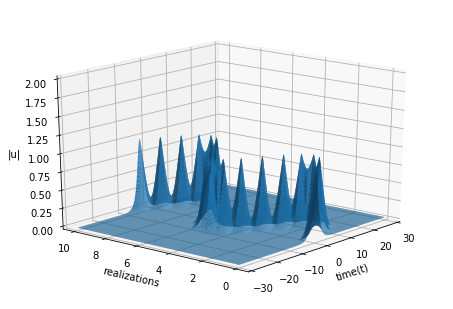

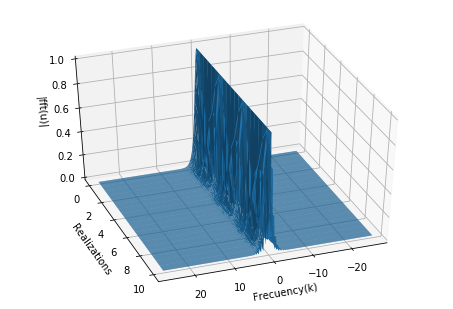

In [11]:
slice=np.linspace(0,10,20)
[T,S]=np.meshgrid(t,slice)
[K,S]=np.meshgrid(k,slice)

U=(1/np.cosh(T-10*np.sin(S)))*np.exp(1j*0*T)
axes=Axes3D(plt.figure())
axes.plot_surface(T,S,U,rstride=1,cstride=1)
plt.xlabel('time(t)')
plt.ylabel('realizations')
axes.set_zlabel('|u|')
plt.xlim([-30,30])
axes.set_zlim(0,2)
axes.view_init(20,-500)

Ut=np.zeros((20,512))
Kp=np.zeros((20,512))
Utp=np.zeros((20,512))
Utn=np.zeros((20,512))
Utnp=np.zeros((20,512))
Un=np.zeros((20,512))
for z in range(0,len(slice)):
    ra = np.zeros(n)
    ra2 = np.zeros(n)
    for i in range(0,n):
         ra[i]=rd.random()
         ra2[i]=rd.random()
    Ut[z,:] =np.fft.fft(U[z,:])
    Kp[z,:]=np.fft.fftshift(K[z,:])
    Utp[z,:] =np.fft.fftshift(Ut[z,:])
    Utn[z,:]= Ut[z,:] + noise*(ra+ra2*1j)
    Utnp[z,:]=np.fft.fftshift(Utn[z,:])/(max(abs(Utn[z,:])))
    Un[z,:]=np.fft.ifft(Utn[z,:])

ax=Axes3D(plt.figure())
ax.plot_surface(Kp,S, abs(Utp)/max(Utp[0,:]),rstride=1, cstride=1)
plt.xlabel('time(t)')
plt.ylabel('realizations')
ax.set_zlabel('|fft(u)|')
plt.xlim([-28,28])
ax.set_zlim(0,1)
plt.xlabel('Frecuency(k)')
plt.ylabel('Realizations')
ax.view_init(40,70)

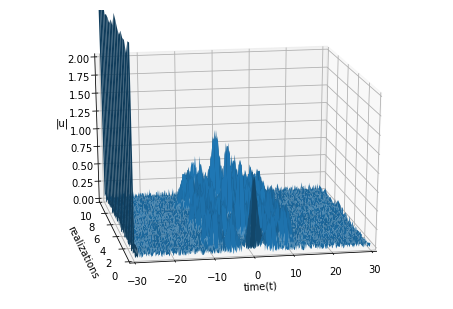

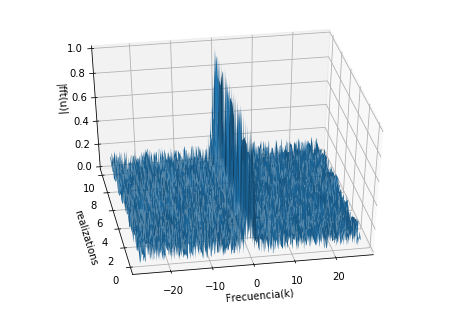

In [12]:
fig = plt.figure()
plt.subplot(2,1,1)
ax=Axes3D(fig)
ax.plot_surface(T,S, abs(Un))
plt.xlabel('time(t)')
plt.ylabel('realizations')
plt.xlim(-30,30)
plt.ylim(0,10)
ax.set_zlabel('|u|')
ax.view_init( 20,-100)
ax.set_zlim(0,2)

fig =plt.figure()
plt.subplot(2,1,2)
ax=Axes3D(fig)

ax.plot_surface(Kp,S, abs(Utnp))
plt.xlabel('Frecuencia(k)')
plt.ylabel('realizations')
ax.set_zlabel('|fft(u)|')
plt.xlim(-28,28)
ax.view_init( 40,-100)
ax.set_zlim(0,1);

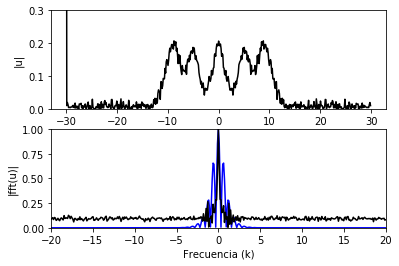

In [13]:
plt.figure()
Uz = np.zeros((1,n))    
Utz= np.zeros((1,n))
for i in range(0,len(slice)):
    Uz= Uz+Un[i,:]
    Utz=Utz+Utn[i,:]
Uz=Uz/len(slice)
Utz=np.fft.fftshift(Utz)/len(slice)

plt.subplot(2,1,1)
plt.plot(t,abs(Uz[0,:]),'k')
plt.ylim(0,0.3)
plt.xlabel('time (t)')
plt.ylabel('|u|')
 
plt.subplot(2,1,2)
plt.plot(ks,abs(np.fft.fftshift(Ut[1,:]))/max(abs(Ut[1,:])),'b-')
plt.plot(ks,abs(Utz[0,:])/max(abs(Utz[0,:])),'k-')
plt.xlim(-20,20)
plt.ylim(0,1)
plt.xlabel('Frecuencia (k)')
plt.ylabel('|fft(u)|');

# Ejemplo

Se tomara una canción y se le aplicará un filtro que remueva ciertas frecuencias con el fin de disminuir el sonido de la guitarra. 

In [43]:
ipd.Audio('The_Strokes-Gratisfaction.wav')

In [16]:
x, sr = librosa.load('The_Strokes-Gratisfaction.wav')

Se almacena los datos de la canción en la variable x y el rate de la canción en sr

In [17]:
print(x.shape)
print(sr)

(3953664,)
22050


Se observa que el tamaño de x es considerable, ya que para procesar esa información requiere tiempo. Mientras que el rate de la canción es 22050. 

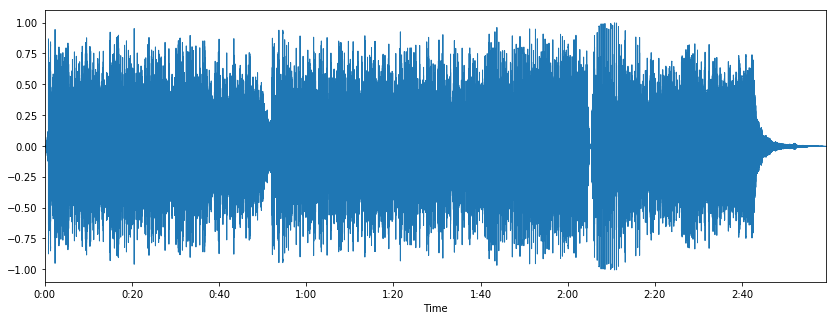

In [18]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr);

Se observan los decibeles de la canción sin modificaciones a las frequencias.

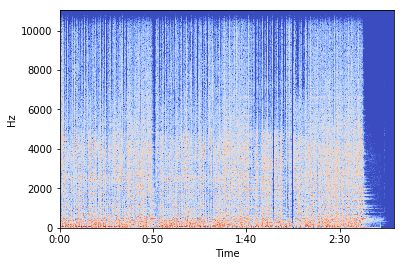

In [19]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz');

Este es el espectro de frecuencias de la canción sin modificarse.

In [20]:
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

In [21]:
def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

In [22]:
filtrado = butter_bandpass_filter(x, 2000, 10000, sr, order=5)

Ahora se filtran las frecuencias que no se encuentren dentro del rango [2000, 10000] por medio de el filtro definido en las entradas 20 y 21. 

In [23]:
#librosa.output.write_wav('Audio_filt.wav', filtrado.astype('float32'), sr)

Se crea o reescribe un archivo .wav con la nueva información filtrada.

In [24]:
ipd.Audio('Audio_filt.wav')

Se puede ensuchar que el audio no es tan claro como el original y tambien se disminuye el volumen de algunas notas de la guitarra en la canción. 

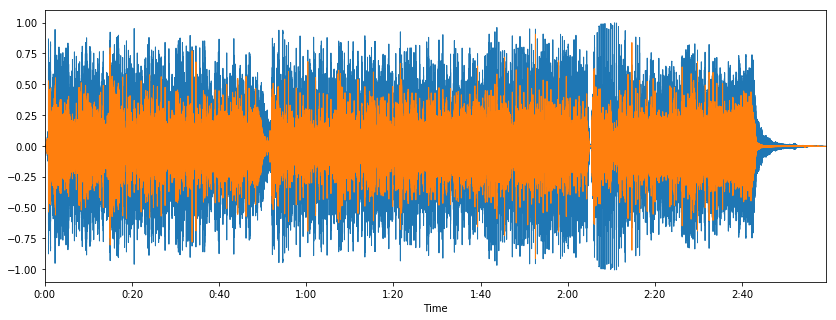

In [25]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)
librosa.display.waveplot(filtrado, sr=sr);

Se comparan los decibeles de las canciones (sin modificar y modificada).

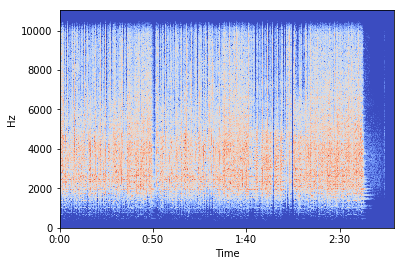

In [26]:
F = librosa.stft(filtrado)
Fdb = librosa.amplitude_to_db(abs(F))
librosa.display.specshow(Fdb, sr=sr, x_axis='time', y_axis='hz');

Se observa que en el espectro de frecuencias de la canción filtrada no se elimina completamente las frecuencias fuera del rango de [2000, 10000]. Por lo que toca tener en cuenta esta desviación. 

A partir de lo anterior se pueden dar las siguientes conclusiones:

* Disminuir las frecuencias disminuye a su vez los decibeles.
* El filtro utilizado no elimina por completo las frecuencias no deseadas, por lo que se puede cambiar de filtro o ajustarlo hasta que cumpla con el rango.
* Los archivos de audio .wav son pesados, por lo que el programa y el cuaderno como tal se demoran en cargar y modificar.
